In [1]:
from bs4 import BeautifulSoup
from selenium import webdriver
#import chromedriver_binary  # Adds chromedriver binary to path
import requests
from more_itertools import sliced
import re
import numpy as np
import pandas as pd
import time
import json

from nltk.tokenize import sent_tokenize
from nltk import *


from IPython.display import clear_output

In [2]:
# ladda txt saken som innehåller id för många explicit fanfics

länkar = []

# open file and read the content in a list
with open('new_explicit.txt', 'r') as filehandle:
    for line in filehandle:
        # remove linebreak which is the last character of the string
        currentPlace = line[:-1]

        # add item to the list
        länkar.append(currentPlace)


In [3]:
links = []
for num in länkar:
    if num[-1] == '"':
        continue
    else:
        links.append(num)
links
len(links)

52580

In [5]:
links[0]

'15360777'

In [45]:
"12939405" in links

False

In [7]:
start = 50001
end = 52579

#start = 1086001
#end = 1089000

In [5]:
lst = []

In [8]:
%%time 
cols = ['link', 'rating', 'category', "fandom", "relationship", "characters", "language", "date", "words", "chapters", "comments", "kudos", "bookmarks", "hits", "title", "author", "story"]





for i in range(start, end):
    time.sleep(1)
    clear_output(wait=True)
    
    url = requests.get("https://archiveofourown.org/works/{}?view_adult=true".format(links[i]))
    time.sleep(1)
    print("Code:  {}   and the number is: {}".format(url.status_code, i ))
    
    if url.status_code == 429:
        time.sleep(20)
        continue
    elif url.status_code != 404:
        html_soup = BeautifulSoup(url.content, 'html.parser')
        #get the link
        y1 = "https://archiveofourown.org/works/{}?view_adult=true".format(links[i])
        
        
        try:
            y17 = html_soup.find("div", class_="userstuff").get_text(separator="\n")
        except: 
            continue

        #This one gets the rating
        try:
            y2 = html_soup.find("dd", class_="rating").get_text().strip()
        except: 
            y2 = float("NaN")


        #This one gets the category
        try:
            y3 = html_soup.find("dd", class_="category").get_text().strip()
        except: 
            y3 = float("NaN")

        #This one gets the fandom   
        try:
            y4 = html_soup.find("dd", class_="fandom").get_text().strip()
        except: 
            y4 = float("NaN")


        #This one gets the relationship  
        try:
            y5 = html_soup.find("dd", class_="relationship").get_text().strip()
        except: 
            y5 = float("NaN")


        #Gets the characters
        try:
            y6 = html_soup.find("dd", class_="character").get_text().strip()
        except: 
            y6 = float("NaN")



        #Gets the language
        try:
            y7 = html_soup.find("dd", class_="language").get_text().strip()
        except: 
            y7 = float("NaN")



        #Gets the date when the fanfiction was published 
        try:
            y8 = html_soup.find("dd", class_="published").get_text().strip()
        except: 
            y8 = float("NaN")


        #Gets the amount of words
        try:
            y9 = int(html_soup.find("dd", class_="words").get_text().strip())
        except: 
            y9 = float("NaN")



        #Gets the amount of chapters
        try:
            y10 = html_soup.find("dd", class_="chapters").get_text().strip()
        except: 
            y10 = float("NaN")


        #Gets the amount of chapters
        try:
            y10 = html_soup.find("dd", class_="chapters").get_text().strip()
        except: 
            y10 = float("NaN")



        #Gets the amount of comments
        try:
            y11 = int(html_soup.find("dd", class_="comments").get_text().strip())
        except: 
            y11 = 0


        #Gets the amount of kudos
        try:
            y12 = int(html_soup.find("dd", class_="kudos").get_text().strip())
        except: 
            y12 = 0



        #Gets the amount of bookmarks
        try:
            y13 = int(html_soup.find("dd", class_="bookmarks").get_text().strip())
        except: 
            y13 = 0




        #Gets the amount of hits
        try:
            y14 = int(html_soup.find("dd", class_="hits").get_text().strip())
        except: 
            y14 = 0



        #Gets the title
        try:
            y15 = html_soup.find("h2", class_="title heading").get_text().strip()
        except: 
            y15 = float("NaN")


        #Gets the author
        try:
            y16 = html_soup.find("h3", class_="byline heading").get_text().strip()
        except: 
            y16 = float("NaN")

        time.sleep(0.8)
        #Gets the story
    
    else:
        time.sleep(2)
        continue
        
    lst.append([y1, y2, y3, y4, y5, y6, y7, y8, y9,y10,y11 ,y12, y13,y14,y15,y16,y17])
    
df1 = pd.DataFrame(lst, columns=cols)


Code:  200   and the number is: 52578
Wall time: 2h 40min 42s


In [11]:
export_csv = df1.to_csv (r'C:\\Users\\GTSA - Infinity\\Desktop\\smut_fanfic_47001_52579.csv', index = None, header=True)

In [9]:
print(len(lst))
print(i)

5567
52578


In [10]:
df1.info(memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5567 entries, 0 to 5566
Data columns (total 17 columns):
link            5567 non-null object
rating          5567 non-null object
category        5507 non-null object
fandom          5567 non-null object
relationship    5407 non-null object
characters      5253 non-null object
language        5567 non-null object
date            5567 non-null object
words           5567 non-null int64
chapters        5567 non-null object
comments        5567 non-null int64
kudos           5567 non-null int64
bookmarks       5567 non-null int64
hits            5567 non-null int64
title           5567 non-null object
author          5567 non-null object
story           5567 non-null object
dtypes: int64(5), object(12)
memory usage: 81.3 MB


In [9]:
df1["rating"].value_counts()

Explicit    3997
Name: rating, dtype: int64

In [26]:
export_csv = fanfic5.to_csv (r'C:\\Users\\GTSA - Infinity\\Desktop\\testar_csv.csv', index = None, header=True)

NameError: name 'fanfic5' is not defined

In [10]:
df1

,link,rating,category,fandom,relationship,characters,language,date,words,chapters,comments,kudos,bookmarks,hits,title,author,story
0,https://archiveofourown.org/works/6704101?view...,Explicit,M/M,Supernatural,Sam Winchester/GabrielSabriel - RelationshipDe...,Sam WinchesterGabrielDean Winchester,English,2016-04-30,1178,1/1,5,272,12,4562,Sin City,orphan_account,Sam took a long drag of his cigarette as he lo...
1,https://archiveofourown.org/works/25017424?vie...,Explicit,F/F,The Last of Us,Dina/Ellie (The Last of Us),Ellie (The Last of Us)Dina (The Last of Us)JJ ...,English,2020-07-01,1860,1/1,5,309,20,5222,You can tell me to stop,raine_fire,Lost to the music playing softly in the backgr...
2,https://archiveofourown.org/works/21172583?vie...,Explicit,M/M,Batman - All Media Types,Dick Grayson/Slade WilsonNightwing/Deathstroke...,Jason ToddDick GraysonSlade Wilsonmentions of ...,English,2019-10-25,1621,1/1,5,152,8,2731,You've Got To Be Fucking Kidding Me,TheFightingBull,"Jason was walking down the sidewalk, enjoying ..."
3,https://archiveofourown.org/works/1040193?view...,Explicit,M/M,The Avengers (Marvel Movies)Iron Man - All Med...,Bruce Banner/Tony Stark,Bruce BannerTony StarkSteve RogersThor (Marvel...,English,2013-11-11,1720,1/1,5,143,19,3743,Purple Shirts and Smirking Shenanigans,thepizzasitter,"""Shall we play, doctor?""\nThe smirks were comm..."
4,https://archiveofourown.org/works/10617102?vie...,Explicit,F/M,Supernatural,Gabriel/ReaderSam Winchester/ReaderGabriel/Rea...,Sam WinchesterGabriel (Supernatural)Reader,English,2017-04-13,2361,1/1,5,208,26,7081,Lick It,WellDoneBeca,“You ready?” Gabriel caressed your face softly...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3992,https://archiveofourown.org/works/23885242?vie...,Explicit,F/M,Haikyuu!!,Azumane Asahi/Reader,Azumane AsahiReader,English,2020-04-28,1937,1/1,4,235,19,5465,Rumors,Smellslikezombies,\n\n I heard he’s a drug dealer. \n\n\n\n\n He...
3993,https://archiveofourown.org/works/21952558?vie...,Explicit,F/FF/MMulti,Original Work,NaN,Santa ClausDaddyMommy - CharacterOriginal Fema...,English,2019-12-25,2102,1/1,4,441,27,50789,I Saw Mommy F*cking Santa Claus,TheOriginalSinner888,Ten-year-old Katie was pretty sure that Santa ...
3994,https://archiveofourown.org/works/22032166?vie...,Explicit,F/M,Naruto,Jiraiya/Tsunade (Naruto),Jiraiya (Naruto)Tsunade (Naruto),English,2019-12-30,2026,1/1,4,41,6,1229,Tsunade's Favorite,yaodai,"The sake was sharp and bitter, tasting more li..."
3995,https://archiveofourown.org/works/13432881?vie...,Explicit,F/M,SupernaturalSPNDean Winchester - Fandom,dean x reader - RelationshipDean Winchester x ...,Dean WinchesterReader,English,2018-01-21,1436,1/1,4,113,10,11949,"Bring It, Baby",evansrogerskitten,Dean had a surprise for you when you got home....


In [4]:
import PyPDF2 as pdf

In [6]:
reader = pdf.PdfFileReader('testar.pdf')

In [15]:
reader.documentInfo
reader.numPages
reader.

<bound method PdfFileReader.getFields of <PyPDF2.pdf.PdfFileReader object at 0x000001D0BE70DE48>>

In [17]:
print(reader.getPage(7-1).extractText())

1Tal
Detf

orstakapitlethandlaromr

akningmedolikatyperavtal.
1.1Depositivaheltalenochdenaturligatalen
Vib

orjarmeddetalmanst

oterpadagligen,n

amligen
positivaheltal
.Det

artalsomr

aknarhela
antal.M

angdenavdepositivaheltalenbetecknas
Z
+
och
Z
+
=
f
1
;
2
;
3
;
4
;:::
g
:
Meddepositivaheltalensaknarvim

ojlighetattuttrycka"ingenting".D

arf

orinf

orvide
naturliga
talen
som

ardepositivaheltaleninklusivetaletnoll
1
.Vibetecknardenaturligatalenmedsymbolen
N
och
N
=
f
0
;
1
;
2
;
3
:::
g
:
Det

arbaranollansomskiljer
N
fran
Z
+
.Eftersomallatalsomnnsi
Z
+
ocksannsi
N
sa

ar
Z
+
en
delm

angd
av
N
,vilketviskriversom
Z
+
ˆ
N
:
Vad

ardetegentligenvig

orn

arviadderartvanaturligatal?Varf

or

artillexempel4+1=5?
Svaret

arattvihar
deierat
attadditionmed1gern

astataliuppr

akningen0
;
1
;
2
;
3
;
4
;
5
;:::
.
Betraktarvitalensomutplaceradepaenlinjekanvit

ankaossadditionmed1somattgaettsteg
tillh

ogerpadenlinjen.Att4+4=8berorpaattn

arvittarossfyrastegtillh

ogerfran4sa
kommerviat

In [22]:
df1

,link,rating,category,fandom,relationship,characters,language,date,words,chapters,comments,kudos,bookmarks,hits,title,author,story
0,https://archiveofourown.org/works/9400751?view...,Explicit,M/M,Yuri!!! on Ice (Anime),Katsuki Yuuri & Victor NikiforovKatsuki Yuuri/...,Katsuki YuuriVictor Nikiforov,English,2017-01-20,2372,1/1,12,402,48,5564,Premarital Preview,Ellidappler,"""It's a shame,"" Yuuri says as soon as they ste..."
1,https://archiveofourown.org/works/22666831?vie...,Explicit,M/M,Haikyuu!!,Kindaichi Yuutarou/Kunimi Akira,Kindaichi YuutarouKunimi Akira,English,2020-02-11,2418,1/1,12,82,8,1187,i’ll teach you.,kinDIEchi (stonerkun420),"\n\n\nThe first time Kunimi brings it up, Kin..."
2,https://archiveofourown.org/works/19979965?vie...,Explicit,M/M,Yuri!!! on Ice (Anime),Katsuki Yuuri/Victor Nikiforov,Katsuki YuuriVictor Nikiforov,English,2019-07-25,2375,1/1,12,439,60,7903,Hungry for You,victurius,"""Come on, baby, you know you want it,"" he whis..."
3,https://archiveofourown.org/works/5526287?view...,Explicit,M/M,Haikyuu!!,Sawamura Daichi/Sugawara Koushi,Sugawara KoushiSawamura Daichi,English,2015-12-25,2071,1/1,12,332,40,3606,Lollipop,inkleafclover,“Suga. Knock it off.”\n“Knock what off?”\nDaic...
4,https://archiveofourown.org/works/13261449?vie...,Explicit,M/M,NCIS,Anthony DiNozzo/Jethro Gibbs,Anthony DiNozzoJethro Gibbs,English,2018-01-04,1959,1/1,12,218,18,9413,Winter,orphan_account,"\n\n\n\n \n“Oh, do we have to?” Tony groaned, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
460,https://archiveofourown.org/works/18098720?vie...,Explicit,M/M,The Umbrella Academy (TV),Diego Hargreeves/Klaus Hargreeves,Diego HargreevesKlaus Hargreeves,English,2019-03-13,1945,1/1,12,93,3,3198,Under Foot,shadowhive,Diego has gotten used to a lot of his siblings...
461,https://archiveofourown.org/works/22936201?vie...,Explicit,M/M,Birds of Prey (And the Fantabulous Emancipatio...,Roman Sionis/Victor Zsasz,NaN,English,2020-02-28,1300,1/1,12,224,23,2145,Blinding Lights,655321,"Roman was swinging hard this morning, one minu..."
462,https://archiveofourown.org/works/4969642?view...,Explicit,M/M,Captain America (Movies),"James ""Bucky"" Barnes/Steve Rogers","Steve RogersJames ""Bucky"" Barnes",English,2015-10-10,2223,1/1,12,279,34,6399,Hope in a Hopeless Place,KittyAugust (KittyAug),"Steve’s back hits the wall hard, he can hear t..."
463,https://archiveofourown.org/works/6233740?view...,Explicit,F/M,Doctor WhoDoctor Who (2005),Ninth Doctor/Rose Tyler,Ninth DoctorRose TylerJack Harkness,English,2016-03-13,2493,1/1,12,103,4,2076,Firmly Grasp it in Your Hand,DoctorRoseAfterDark (lastbluetardis),"“I can’t believe you’re getting so offended, D..."


In [67]:
fanfic = pd.read_csv("fanfic_python_1000000_1009000.csv")

In [5]:
fanfic.head()

,link,rating,category,fandom,relationship,characters,language,date,words,chapters,comments,kudos,bookmarks,hits,title,author,story
0,https://archiveofourown.org/works/1000000?view...,Mature,M/M,Thor (Movies)Thor - All Media TypesTangled (2010),Loki/Thor,Loki (Marvel)Thor (Marvel)Sif (Marvel),English,2013-10-11,4271,1/1,16,225,21,5243,Golden,cm (mumblemutter),"The war is long, and bloody. Loki has gathered..."
1,https://archiveofourown.org/works/1000001?view...,Explicit,M/M,Doctor Who (1963)Doctor Who (2005)Doctor Who,The Doctor/The Master (Doctor Who),The Doctor (Doctor Who)First DoctorSecond Doct...,Español,2013-10-11,4870,2/?,0,1,0,196,The Ballad of a Tragic Fate,Badguy_x_Moores,\n\nChapter Text\n\n\nMiraba aquella pequeña c...
2,https://archiveofourown.org/works/1000002?view...,Teen And Up Audiences,Gen,Teen Wolf (TV)One Direction (Band),NaN,Zayn MalikDerek HaleCora HalePatricia MalikYas...,English,2013-10-11,4062,1/1,2,33,2,740,You Always Find Your Way Home,harrythe,Zayn Hale was ten years old the year his famil...
3,https://archiveofourown.org/works/1000003?view...,General Audiences,Gen,Bleach,NaN,Inoue Orihime,English,2013-10-11,100,1/1,0,0,0,159,this world's a stage,dreamweavernyx,"Orihime’s a good actress, forever hiding her s..."
4,https://archiveofourown.org/works/1000004?view...,General Audiences,F/M,Doctor Who,Tenth Doctor/Rose Tyler,Tenth DoctorRose Tyler,English,2013-10-11,423,1/1,5,18,0,303,Visiting Barcelona,Im_The_Doctor (Bofur1),"\n\n""How do I look?""\n\n\n\n\n""Different.""\n\n..."


In [8]:
print(fanfic.iloc[0,16])

The war is long, and bloody. Loki has gathered an army, and his own seidr is formidable. Thor is barely trained, and yet finds himself in the midst of battle, felling monsters left and right. Sif fights by his side, tells him to stay strong. "We can do this," she says, and her reassurance is calming, her presence a rock that steadies him.
He'd married her, before the war started. She told him him that it did not matter that he had never learnt the ways of the sword, that she would protect him, and the kingdom, until he learnt to defend himself. "You are the son of Odin," she said. "The power was always within you."
"The Lady Sif is a good choice," Frigga said on their wedding day, and when she enveloped him in a hug it took all his will not to break himself free. "We will be rid of all of this madness soon enough, you will see."
She did not understand, and neither does Sif.
It was always meant to be him and Loki, in the end. 
The tower is shorter than he remembers it. He finds the door

In [10]:
from transformers import BertTokenizer

In [11]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [57]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True)

In [61]:
tokenizer.tokenize(fanfic.iloc[1,16])

['ra',
 '##du',
 'was',
 'quietly',
 'enjoying',
 'a',
 'book',
 'in',
 'the',
 'sitting',
 'room',
 'when',
 'he',
 '##lga',
 'glided',
 'in',
 '.',
 '“',
 'ra',
 '##du',
 ',',
 'do',
 'you',
 'mind',
 'doing',
 'me',
 'a',
 'favour',
 '?',
 '”',
 'she',
 'bent',
 'over',
 'the',
 'younger',
 'met',
 '##hus',
 '##ela',
 '##h',
 ',',
 'offering',
 'him',
 'a',
 'generous',
 'view',
 'of',
 'her',
 'ample',
 'cleavage',
 '.',
 '“',
 'sure',
 'thing',
 '…',
 '”',
 'ra',
 '##du',
 'replied',
 '.',
 'as',
 'a',
 'new',
 'recruit',
 ',',
 'he',
 'didn',
 '’',
 't',
 'want',
 'to',
 'ant',
 '##ago',
 '##ni',
 '##ze',
 'his',
 'or',
 '##den',
 'superiors',
 'if',
 'he',
 'could',
 'help',
 'it',
 '.',
 '“',
 'mein',
 'herr',
 'wants',
 'the',
 'panzer',
 'mag',
 '##ier',
 'now',
 '.',
 'isa',
 '##ak',
 '’',
 's',
 'in',
 'his',
 'chamber',
 '.',
 'would',
 'you',
 'be',
 'a',
 'dear',
 'and',
 'go',
 'fetch',
 'him',
 '?',
 '”',
 'he',
 '##lga',
 'fluttered',
 'her',
 'eyelashes',
 'and',
 'p

In [18]:
fanfic["rating"].value_counts()

General Audiences        1721
Teen And Up Audiences    1716
Explicit                 1051
Mature                    993
Not Rated                 539
Name: rating, dtype: int64

In [31]:
fanfic["rating"] == "Mature" 

0        True
1       False
2       False
3       False
4       False
        ...  
6015    False
6016    False
6017    False
6018    False
6019    False
Name: rating, Length: 6020, dtype: bool

In [68]:
fanfic =fanfic[(fanfic.rating == "General Audiences") |  (fanfic.rating == "Explicit")]

#fanfic =fanfic[fanfic.rating == "Explicit"]
fanfic

,link,rating,category,fandom,relationship,characters,language,date,words,chapters,comments,kudos,bookmarks,hits,title,author,story
1,https://archiveofourown.org/works/1000001?view...,Explicit,M/M,Doctor Who (1963)Doctor Who (2005)Doctor Who,The Doctor/The Master (Doctor Who),The Doctor (Doctor Who)First DoctorSecond Doct...,Español,2013-10-11,4870,2/?,0,1,0,196,The Ballad of a Tragic Fate,Badguy_x_Moores,\n\nChapter Text\n\n\nMiraba aquella pequeña c...
3,https://archiveofourown.org/works/1000003?view...,General Audiences,Gen,Bleach,NaN,Inoue Orihime,English,2013-10-11,100,1/1,0,0,0,159,this world's a stage,dreamweavernyx,"Orihime’s a good actress, forever hiding her s..."
4,https://archiveofourown.org/works/1000004?view...,General Audiences,F/M,Doctor Who,Tenth Doctor/Rose Tyler,Tenth DoctorRose Tyler,English,2013-10-11,423,1/1,5,18,0,303,Visiting Barcelona,Im_The_Doctor (Bofur1),"\n\n""How do I look?""\n\n\n\n\n""Different.""\n\n..."
5,https://archiveofourown.org/works/1000005?view...,Explicit,M/M,Trinity Blood,Radu Barvon/Dietrich von LohengrinRadu Barvon/...,Radu BarvonDietrich von LohengrinIsaak Fernand...,English,2013-10-11,2542,1/1,0,11,2,900,The Devil and the Deep Blue Sea,Umeko,Radu was quietly enjoying a book in the sittin...
7,https://archiveofourown.org/works/1000007?view...,General Audiences,Gen,Young Justice (Cartoon)Young Justice,NaN,NaN,English,2013-10-11,9186,3/?,0,8,0,277,Young Wizards,Hezpeller,\n\nChapter Text\n\n\nDick gripped the polishe...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6005,https://archiveofourown.org/works/1008967?view...,Explicit,F/M,Supernatural,Dean Winchester/Original Female Character(s),Dean WinchesterFemale Character - Character,English,2013-10-18,3361,1/?,1,22,3,950,Slumbering Apparitions,Dustybaby,\n\nChapter Text\n\n\n\n\n\n\nSlumbering Appar...
6011,https://archiveofourown.org/works/1008982?view...,General Audiences,M/M,One Direction (Band),Liam Payne/Louis Tomlinson,Liam PayneLouis Tomlinson,English,2013-10-18,500,1/1,4,41,4,2392,You can't go to bed without a cup of tea,Lulu_Horan,Louis snuggled up to Liam with a big smile on ...
6013,https://archiveofourown.org/works/1008988?view...,General Audiences,Gen,Legend of Zelda: The Ocarina of Time,NaN,LinkDark LinkFem!Dark Link,English,2013-10-18,680,1/1,2,8,2,419,Always,OatBreeze,Link was pretty sure someone was following him...
6014,https://archiveofourown.org/works/1008989?view...,General Audiences,Gen,The Avengers (Marvel Movies)The Avengers (Marv...,Clint Barton/Natasha Romanov,Natasha RomanovClint BartonOCs,English,2013-10-18,319,1/1,4,62,2,2114,Swapping Places,f_romanoff_13,Natasha sighed inwardly as Evie passed her a l...


In [6]:
# ladda txt saken som innehåller id för många explicit fanfics

länkar = []

# open file and read the content in a list
with open('explicit_fanfic_list_id.txt', 'r') as filehandle:
    for line in filehandle:
        # remove linebreak which is the last character of the string
        currentPlace = line[:-1]

        # add item to the list
        länkar.append(currentPlace)

In [7]:
len(länkar)

45940

In [8]:
links = []
for num in länkar:
    if num[-1] == '"':
        continue
    else:
        links.append(num)

In [9]:
for i in range(1,10):
    print("https://archiveofourown.org/works/{}?view_adult=true".format(links[i]))

https://archiveofourown.org/works/20202019?view_adult=true
https://archiveofourown.org/works/26159902?view_adult=true
https://archiveofourown.org/works/25382134?view_adult=true
https://archiveofourown.org/works/24381382?view_adult=true
https://archiveofourown.org/works/25752028?view_adult=true
https://archiveofourown.org/works/11811723?view_adult=true
https://archiveofourown.org/works/25881670?view_adult=true
https://archiveofourown.org/works/25422994?view_adult=true
https://archiveofourown.org/works/24901402?view_adult=true


In [38]:
from nltk.tokenize import sent_tokenize
from nltk import *

In [65]:
# Detta skapar en lista med meningar

testar = sent_tokenize(fanfic.iloc[6,16])
testar

['“I don’t care where we end up living,” Hermann had said, in a hotel in Boston in the middle of their lecture tour.',
 '“But I have two conditions: first, the region must be temperate.',
 'I don’t want to ever feel like I’m going to die if I spend more than ten minutes outdoors.',
 'And second, the house we live in must have large windows.',
 'I spent ten years hearing and feeling the weather, but not having the privilege of seeing it.”\n\n\nThis second condition, Newt found perplexing.',
 'Hermann had always struck him as someone who was indifferent to things like sunshine.',
 'Then again, all the years they had spent together had indeed been in the confines of a large windowless metal box, so perhaps indifference to sunshine had simply been a coping strategy.',
 'Looking over their numerous offers at the end of the tour, the two of them narrowed it down to Oxford or Cambridge, and flipped a coin.',
 'Then Newt spent an ungodly chunk of money having a house built for them and furnish

In [56]:
testar[4]

'I spent ten years hearing and feeling the weather, but not having the privilege of seeing it.”\n\n\nThis second condition, Newt found perplexing.'

In [60]:
fanfic.iloc[1,16]

'Radu was quietly enjoying a book in the sitting room when Helga glided in. “Radu, do you mind doing me a favour?” She bent over the younger Methuselah, offering him a generous view of her ample cleavage. “Sure thing…” Radu replied. As a new recruit, he didn’t want to antagonize his Orden superiors if he could help it.\xa0\n“Mein Herr wants the Panzer Magier now. Isaak’s in his chamber. Would you be a dear and go fetch him?” Helga fluttered her eyelashes and pouted petulantly. Radu groaned inwardly. She could have said, “Radu, would you like to be torn apart by Isaak’s pet demons?”\nWhen Isaak took to his chambers, it meant that he didn’t want to be disturbed, least of all by some fresh recruit. Other than Mein Herr, only his valet-chauffeur-bodyguard Reiz was allowed to call on Isaak at those times. However, as the valet was away on a mission, Cain obviously decided to let some unsuspecting fool be on the receiving end of Isaak’s wrath. And Helga just assigned him to call Isaak.\n“Do 

In [69]:
fanfic["rating"].value_counts()

General Audiences    1721
Explicit             1051
Name: rating, dtype: int64

In [74]:
from sklearn.preprocessing import LabelEncoder

LE = LabelEncoder()
fanfic["label"] = LE.fit_transform(fanfic['rating'])

fanfic

,link,rating,category,fandom,relationship,characters,language,date,words,chapters,comments,kudos,bookmarks,hits,title,author,story,label
1,https://archiveofourown.org/works/1000001?view...,Explicit,M/M,Doctor Who (1963)Doctor Who (2005)Doctor Who,The Doctor/The Master (Doctor Who),The Doctor (Doctor Who)First DoctorSecond Doct...,Español,2013-10-11,4870,2/?,0,1,0,196,The Ballad of a Tragic Fate,Badguy_x_Moores,\n\nChapter Text\n\n\nMiraba aquella pequeña c...,0
3,https://archiveofourown.org/works/1000003?view...,General Audiences,Gen,Bleach,NaN,Inoue Orihime,English,2013-10-11,100,1/1,0,0,0,159,this world's a stage,dreamweavernyx,"Orihime’s a good actress, forever hiding her s...",1
4,https://archiveofourown.org/works/1000004?view...,General Audiences,F/M,Doctor Who,Tenth Doctor/Rose Tyler,Tenth DoctorRose Tyler,English,2013-10-11,423,1/1,5,18,0,303,Visiting Barcelona,Im_The_Doctor (Bofur1),"\n\n""How do I look?""\n\n\n\n\n""Different.""\n\n...",1
5,https://archiveofourown.org/works/1000005?view...,Explicit,M/M,Trinity Blood,Radu Barvon/Dietrich von LohengrinRadu Barvon/...,Radu BarvonDietrich von LohengrinIsaak Fernand...,English,2013-10-11,2542,1/1,0,11,2,900,The Devil and the Deep Blue Sea,Umeko,Radu was quietly enjoying a book in the sittin...,0
7,https://archiveofourown.org/works/1000007?view...,General Audiences,Gen,Young Justice (Cartoon)Young Justice,NaN,NaN,English,2013-10-11,9186,3/?,0,8,0,277,Young Wizards,Hezpeller,\n\nChapter Text\n\n\nDick gripped the polishe...,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6005,https://archiveofourown.org/works/1008967?view...,Explicit,F/M,Supernatural,Dean Winchester/Original Female Character(s),Dean WinchesterFemale Character - Character,English,2013-10-18,3361,1/?,1,22,3,950,Slumbering Apparitions,Dustybaby,\n\nChapter Text\n\n\n\n\n\n\nSlumbering Appar...,0
6011,https://archiveofourown.org/works/1008982?view...,General Audiences,M/M,One Direction (Band),Liam Payne/Louis Tomlinson,Liam PayneLouis Tomlinson,English,2013-10-18,500,1/1,4,41,4,2392,You can't go to bed without a cup of tea,Lulu_Horan,Louis snuggled up to Liam with a big smile on ...,1
6013,https://archiveofourown.org/works/1008988?view...,General Audiences,Gen,Legend of Zelda: The Ocarina of Time,NaN,LinkDark LinkFem!Dark Link,English,2013-10-18,680,1/1,2,8,2,419,Always,OatBreeze,Link was pretty sure someone was following him...,1
6014,https://archiveofourown.org/works/1008989?view...,General Audiences,Gen,The Avengers (Marvel Movies)The Avengers (Marv...,Clint Barton/Natasha Romanov,Natasha RomanovClint BartonOCs,English,2013-10-18,319,1/1,4,62,2,2114,Swapping Places,f_romanoff_13,Natasha sighed inwardly as Evie passed her a l...,1


In [91]:
# Only english langueage 

fanfic = fanfic[fanfic["language"] == "English"]

fanfic

,link,rating,category,fandom,relationship,characters,language,date,words,chapters,comments,kudos,bookmarks,hits,title,author,story,label
3,https://archiveofourown.org/works/1000003?view...,General Audiences,Gen,Bleach,NaN,Inoue Orihime,English,2013-10-11,100,1/1,0,0,0,159,this world's a stage,dreamweavernyx,"Orihime’s a good actress, forever hiding her s...",1
4,https://archiveofourown.org/works/1000004?view...,General Audiences,F/M,Doctor Who,Tenth Doctor/Rose Tyler,Tenth DoctorRose Tyler,English,2013-10-11,423,1/1,5,18,0,303,Visiting Barcelona,Im_The_Doctor (Bofur1),"\n\n""How do I look?""\n\n\n\n\n""Different.""\n\n...",1
5,https://archiveofourown.org/works/1000005?view...,Explicit,M/M,Trinity Blood,Radu Barvon/Dietrich von LohengrinRadu Barvon/...,Radu BarvonDietrich von LohengrinIsaak Fernand...,English,2013-10-11,2542,1/1,0,11,2,900,The Devil and the Deep Blue Sea,Umeko,Radu was quietly enjoying a book in the sittin...,0
7,https://archiveofourown.org/works/1000007?view...,General Audiences,Gen,Young Justice (Cartoon)Young Justice,NaN,NaN,English,2013-10-11,9186,3/?,0,8,0,277,Young Wizards,Hezpeller,\n\nChapter Text\n\n\nDick gripped the polishe...,1
8,https://archiveofourown.org/works/1000008?view...,General Audiences,Gen,Hetalia: Axis Powers,America (Hetalia) & England (Hetalia),America (Hetalia: Axis Powers)England (Hetalia...,English,2013-10-11,849,1/1,4,40,11,526,You Don't,eloquentelegance,"""England?"" He asks, worrying at his bottom lip...",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6005,https://archiveofourown.org/works/1008967?view...,Explicit,F/M,Supernatural,Dean Winchester/Original Female Character(s),Dean WinchesterFemale Character - Character,English,2013-10-18,3361,1/?,1,22,3,950,Slumbering Apparitions,Dustybaby,\n\nChapter Text\n\n\n\n\n\n\nSlumbering Appar...,0
6011,https://archiveofourown.org/works/1008982?view...,General Audiences,M/M,One Direction (Band),Liam Payne/Louis Tomlinson,Liam PayneLouis Tomlinson,English,2013-10-18,500,1/1,4,41,4,2392,You can't go to bed without a cup of tea,Lulu_Horan,Louis snuggled up to Liam with a big smile on ...,1
6013,https://archiveofourown.org/works/1008988?view...,General Audiences,Gen,Legend of Zelda: The Ocarina of Time,NaN,LinkDark LinkFem!Dark Link,English,2013-10-18,680,1/1,2,8,2,419,Always,OatBreeze,Link was pretty sure someone was following him...,1
6014,https://archiveofourown.org/works/1008989?view...,General Audiences,Gen,The Avengers (Marvel Movies)The Avengers (Marv...,Clint Barton/Natasha Romanov,Natasha RomanovClint BartonOCs,English,2013-10-18,319,1/1,4,62,2,2114,Swapping Places,f_romanoff_13,Natasha sighed inwardly as Evie passed her a l...,1


In [92]:
fanfic2 = fanfic.iloc[:,16:]

In [95]:
fanfic2["label"].value_counts()
#1 = General, 0 = explicit



1    1628
0     982
Name: label, dtype: int64

In [96]:
fanfic2

,story,label
3,"Orihime’s a good actress, forever hiding her s...",1
4,"\n\n""How do I look?""\n\n\n\n\n""Different.""\n\n...",1
5,Radu was quietly enjoying a book in the sittin...,0
7,\n\nChapter Text\n\n\nDick gripped the polishe...,1
8,"""England?"" He asks, worrying at his bottom lip...",1
...,...,...
6005,\n\nChapter Text\n\n\n\n\n\n\nSlumbering Appar...,0
6011,Louis snuggled up to Liam with a big smile on ...,1
6013,Link was pretty sure someone was following him...,1
6014,Natasha sighed inwardly as Evie passed her a l...,1


In [99]:
fanfic2[fanfic2["label"] == 1].head(1000)

,story,label
3,"Orihime’s a good actress, forever hiding her s...",1
4,"\n\n""How do I look?""\n\n\n\n\n""Different.""\n\n...",1
7,\n\nChapter Text\n\n\nDick gripped the polishe...,1
8,"""England?"" He asks, worrying at his bottom lip...",1
9,"\n\nTo listen to new messages, press one.\n\n\...",1
...,...,...
3602,If there was one thing that Rumplestiltskin re...,1
3608,\n///\ngrowing up in that town is asphyxiatin...,1
3609,It had been a month and yet here she was again...,1
3611,"Your name is Damara Megido, and you are tired....",1


In [101]:
# make equal number of observations
fanfic2 = pd.concat([fanfic2[fanfic2["label"] == 1].head(1000), fanfic2[fanfic2["label"] == 0].head(1000)])

In [106]:
fanfic3 = fanfic2.sample(frac=1)

In [109]:
fanfic3

,story,label
122,Jason's not sure if he's the luckiest man aliv...,0
4531,"To Javert, anticipation has always been its ow...",0
381,"""So, that's it?""\nThey'd arrived in the City o...",1
2349,\n\nChapter Text\n\n\n“And a good morning to y...,1
4760,"""And that's good, isn't it?""\nAndo's question ...",0
...,...,...
13,Taylor's born with an empty space in his chest...,1
3316,\n\nChapter Text\n\n\n“Sooo… you’re \nBerwald ...,0
5531,Harry gritted his teeth against the soreness i...,0
2200,"\nAt times like this, Chaos often finds his he...",1


In [111]:
fanfic4 = fanfic3
fanfic4["count"] =fanfic3['story'].str.findall(r'(\w+)').str.len()

In [124]:
fanfic4 = fanfic4[fanfic4["count"] < 4000]
fanfic4

,story,label,count
122,Jason's not sure if he's the luckiest man aliv...,0,2400
4531,"To Javert, anticipation has always been its ow...",0,1667
381,"""So, that's it?""\nThey'd arrived in the City o...",1,2122
2349,\n\nChapter Text\n\n\n“And a good morning to y...,1,833
4760,"""And that's good, isn't it?""\nAndo's question ...",0,3121
...,...,...,...
3446,"\n\n\n\n\n\n\n\n\n\nLoki-child, eyes full of t...",1,49
198,He didn’t know how long he’d been held. Time ...,1,1030
13,Taylor's born with an empty space in his chest...,1,2291
3316,\n\nChapter Text\n\n\n“Sooo… you’re \nBerwald ...,0,2944


In [113]:
import seaborn as sns

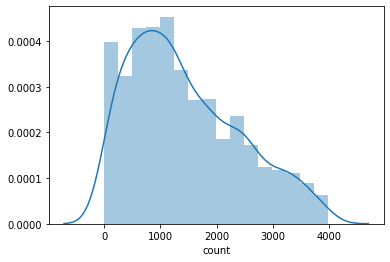

In [128]:
sns.distplot(fanfic4["count"])

In [126]:
fanfic4["label"].value_counts()

1    930
0    672
Name: label, dtype: int64

In [131]:
fanfic4["story"] = fanfic4["story"].str.lower()
fanfic4.l

,story,label,count
122,jason's not sure if he's the luckiest man aliv...,0,2400
4531,"to javert, anticipation has always been its ow...",0,1667
381,"""so, that's it?""\nthey'd arrived in the city o...",1,2122
2349,\n\nchapter text\n\n\n“and a good morning to y...,1,833
4760,"""and that's good, isn't it?""\nando's question ...",0,3121
...,...,...,...
3446,"\n\n\n\n\n\n\n\n\n\nloki-child, eyes full of t...",1,49
198,he didn’t know how long he’d been held. time ...,1,1030
13,taylor's born with an empty space in his chest...,1,2291
3316,\n\nchapter text\n\n\n“sooo… you’re \nberwald ...,0,2944


In [134]:
fanfic4 = fanfic4.iloc[:,0:2]

In [135]:
fanfic4 

,story,label
122,jason's not sure if he's the luckiest man aliv...,0
4531,"to javert, anticipation has always been its ow...",0
381,"""so, that's it?""\nthey'd arrived in the city o...",1
2349,\n\nchapter text\n\n\n“and a good morning to y...,1
4760,"""and that's good, isn't it?""\nando's question ...",0
...,...,...
3446,"\n\n\n\n\n\n\n\n\n\nloki-child, eyes full of t...",1
198,he didn’t know how long he’d been held. time ...,1
13,taylor's born with an empty space in his chest...,1
3316,\n\nchapter text\n\n\n“sooo… you’re \nberwald ...,0


In [139]:
import spacy

# LADDA SPACY MODEL

In [144]:



import en_core_web_sm
nlp = en_core_web_sm.load()

In [150]:
mening = nlp(fanfic4.iloc[0,0])

for word in mening:
    print(word.text,  word.pos_, word.dep_)

jason PROPN nsubj
's VERB ROOT
not ADV neg
sure ADJ acomp
if ADP mark
he PRON nsubj
's VERB ccomp
the DET det
luckiest ADJ amod
man NOUN nsubj
alive ADJ acomp
or CCONJ cc
the DET det
stupidest ADJ conj
. PUNCT punct



 SPACE 
dick NOUN nsubj
nearly ADV advmod
drops VERB ROOT
his DET poss
glass NOUN dobj
as ADP prep
tim NOUN nmod

 SPACE 
nuzzles NOUN pobj

  SPACE 
up ADP prep
to ADP prep
him PRON pobj
. PUNCT punct
lips NOUN ROOT
close ADV amod
to ADP prep
the DET det
sensitive ADJ amod
skin NOUN pobj
of ADP prep
his DET poss
neck NOUN pobj
, PUNCT punct
and CCONJ cc
jason NOUN nsubj
does VERB aux
n't ADV neg
need VERB conj
to PART aux
be VERB xcomp
over ADV advmod
there ADV advmod
to PART aux
know VERB advcl
it PRON nsubj
's VERB aux
having VERB ccomp
an DET det
obvious ADJ amod
effect NOUN dobj
on ADP prep
dick NOUN pobj
. PUNCT punct
one NUM ROOT
that DET pobj
he PRON nsubj
feels VERB relcl
uncomfortable ADJ acomp
with ADP prep
if ADP mark
the DET det
way NOUN nsubj
he PRON nsubj


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



CCONJ cc
bare ADJ conj
, PUNCT punct
but CCONJ cc
the DET det
shift NOUN nsubj
of ADP prep
his DET poss
eyes NOUN pobj
and CCONJ cc
the DET det
emphasizing NOUN conj
of ADP prep
his DET poss
lips NOUN pobj
means VERB conj
he PRON nsubj
spent VERB ccomp
a DET det
good ADJ amod
long ADJ dobj
while NOUN prep
in ADP prep
front NOUN pobj
of ADP prep
a DET det
mirror NOUN pobj
to PART aux
get VERB relcl
that DET det
look NOUN dobj
. PUNCT punct
he PRON nsubj
looks VERB ROOT
hot ADJ acomp
as ADP prep
fuck NOUN pobj
and CCONJ cc
jason NOUN nsubj
's VERB conj
not ADV neg
the DET det
only ADJ amod
man NOUN attr
looking VERB acl
at ADP prep
dick NOUN pobj
with ADP prep
jealousy NOUN pobj
as ADP mark
tim NOUN nsubj
tucks VERB advcl
himself PRON dobj
into ADP prep
the DET det
curve NOUN pobj
of ADP prep
the DET det
man NOUN poss
's PART case
free ADJ amod
arm NOUN pobj
. PUNCT punct



 SPACE 
" PUNCT punct
jesus NOUN compound
fuck NOUN ROOT
, PUNCT punct
" PUNCT punct
jason ADJ compound
mutters NO

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



" PUNCT punct

 SPACE 
mine NOUN dobj
. PUNCT punct

 SPACE 
" PUNCT ROOT



 SPACE 
" PUNCT punct
why ADV ROOT
, PUNCT punct
mr X intj
. PUNCT punct
todd NOUN amod
, PUNCT punct
" PUNCT punct
tim NOUN compound
murmurs NOUN ROOT
as ADP mark
his DET poss
eyes NOUN nsubj
shutter VERB advcl
. PUNCT punct
a DET det
bare ADJ amod
sliver NOUN ROOT
of ADP prep
blue ADJ pobj
peering VERB acl
up PART prt
at ADP prep
him PRON pobj
. PUNCT punct
one NUM nsubj
of ADP prep
his DET poss
legs NOUN pobj
bends NOUN ROOT
and CCONJ cc
comes VERB conj
up PART prt
. PUNCT punct
just ADV advmod
enough ADV ROOT
to PART aux
press VERB xcomp
interestingly ADV advmod
against ADP prep
the DET det
front NOUN pobj
of ADP prep
jason NOUN poss
's PART case
pants NOUN pobj
. PUNCT punct
rubbing VERB ROOT
lightly ADV advmod
, PUNCT punct
teasingly ADV advmod
. PUNCT punct
" PUNCT ROOT
i PRON nsubj
do VERB aux
n't ADV neg
think VERB ROOT
we PRON nsubj
're VERB aux
having VERB ccomp
the DET det
same ADJ amod
conversatio

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 det
scent NOUN pobj
and CCONJ cc
taste NOUN conj
and CCONJ cc
feel VERB conj
of ADP prep
the DET det
tim NOUN pobj
. PUNCT punct



 SPACE 
tim NOUN nsubj
pushes NOUN ROOT
when ADV advmod
jason NOUN compound
shudders NOUN advcl
to ADP prep
a DET det
stop NOUN pobj
and CCONJ cc
he PRON nsubj
falls VERB ROOT
onto ADP prep
his DET poss
ass NOUN pobj
as ADP mark
tim NOUN nsubj
slides VERB advcl
down PART prt
to PART aux
fold VERB advcl
up PART prt
into ADP prep
his DET poss
lap NOUN pobj
. PUNCT punct
tim NOUN poss
's PART case
eyes NOUN nsubj
are VERB ccomp
hard ADJ acomp
and CCONJ cc
hot ADJ conj
as ADP mark
he PRON nsubj
traces VERB advcl
a DET det
streak NOUN nsubj
of ADP prep
his DET poss
own ADJ pobj
come NOUN ROOT
across ADP prep
jason NOUN poss
's PART case
face NOUN pobj
with ADP prep
a DET det
sharp ADJ amod
pointed ADJ amod
nail NOUN pobj
. PUNCT punct
his DET poss
thumb NOUN nsubj
coming VERB advcl
up PART advmod
to PART prep

 SPACE 
rub VERB ROOT

  SPACE 
it PRON dobj
into 

In [148]:
print(fanfic4.iloc[0,0])

jason's not sure if he's the luckiest man alive or the stupidest.


dick nearly drops his glass as tim 
nuzzles
 up to him. lips close to the sensitive skin of his neck, and jason doesn't need to be over there to know it's having an obvious effect on dick. one that he feels uncomfortable with if the way he's trying to edge away from tim is any indication.


"this is your fault," damian hisses from jason's elbow. his face finally calming back down from the solid red it had been when he'd escaped tim's clutches earlier. he's still eying tim like most people would eye a venomous snake and working hard to keep jason solidly between them with every turn tim takes around the room. "none of this would have happened if you had not called drake's bluff."


jason wants to argue but it's true. it is all jason's fault. his hilarious fucking idea to take perfect little timothy drake down a notch or two. get that prissy smart ass to loosen up and realize he's just as human as the rest of them. not a

 jason after him.


In [149]:
fanfic4

,story,label
122,jason's not sure if he's the luckiest man aliv...,0
4531,"to javert, anticipation has always been its ow...",0
381,"""so, that's it?""\nthey'd arrived in the city o...",1
2349,\n\nchapter text\n\n\n“and a good morning to y...,1
4760,"""and that's good, isn't it?""\nando's question ...",0
...,...,...
3446,"\n\n\n\n\n\n\n\n\n\nloki-child, eyes full of t...",1
198,he didn’t know how long he’d been held. time ...,1
13,taylor's born with an empty space in his chest...,1
3316,\n\nchapter text\n\n\n“sooo… you’re \nberwald ...,0


In [184]:
import spacy
from spacy import displacy
from collections import Counter
import en_core_web_sm
nlp = en_core_web_sm.load()


doc = nlp('European authorities fined Google a record $5.1 billion on Wednesday for abusing its power in the mobile phone market and ordered the company to alter its practices')
pprint([(X.text, X.label_) for X in doc.ents])

[('European', 'NORP'),
 ('Google', 'ORG'),
 ('$5.1 billion', 'MONEY'),
 ('Wednesday', 'DATE')]


In [186]:
sentences = list(doc.sents)
for sentence in sentences:
    print (sentence)

European authorities fined Google a record $5.1 billion on Wednesday for abusing its power in the mobile phone market and ordered the company to alter its practices


In [187]:

doc = nlp(fanfic.iloc[0,16])
sentences = list(doc.sents)
for sentence in sentences:
    print (sentence)

Orihime’s a good actress, forever hiding her skill of reading people beneath a harmless façade.


 



War is tough, and Orihime can see how it has sunk its claws deep into Ishida, into Sado, and into Kurosaki.
She sees how it takes a toll on the way they fight, that as the war drags on they become more jaded, bitter, withdrawn.


 



So she puts on a smile and acts like her ditzy self, if only to see the lines of tension in their shoulders ease a little, because they’re 

her
 boys and all she wants is to see them happy again.


In [188]:
fanfic.iloc[0,16]

'Orihime’s a good actress, forever hiding her skill of reading people beneath a harmless façade.\n\n\n\xa0\n\n\nWar is tough, and Orihime can see how it has sunk its claws deep into Ishida, into Sado, and into Kurosaki. She sees how it takes a toll on the way they fight, that as the war drags on they become more jaded, bitter, withdrawn.\n\n\n\xa0\n\n\nSo she puts on a smile and acts like her ditzy self, if only to see the lines of tension in their shoulders ease a little, because they’re \nher\n boys and all she wants is to see them happy again.'

In [192]:
# nltk ovanför verkar bättre på meningen
test = sent_tokenize(fanfic.iloc[0,16])

for mening in test:
    print(mening + "\n")

Orihime’s a good actress, forever hiding her skill of reading people beneath a harmless façade.

War is tough, and Orihime can see how it has sunk its claws deep into Ishida, into Sado, and into Kurosaki.

She sees how it takes a toll on the way they fight, that as the war drags on they become more jaded, bitter, withdrawn.

So she puts on a smile and acts like her ditzy self, if only to see the lines of tension in their shoulders ease a little, because they’re 
her
 boys and all she wants is to see them happy again.



In [210]:
# Get stopwords
# https://realpython.com/natural-language-processing-spacy-python/
# Ovanför is a guide to spacy

spacy_stopwords = spacy.lang.en.stop_words.STOP_WORDS
print(len(spacy_stopwords))
spacy_stopwords

326


{"'d",
 "'ll",
 "'m",
 "'re",
 "'s",
 "'ve",
 'a',
 'about',
 'above',
 'across',
 'after',
 'afterwards',
 'again',
 'against',
 'all',
 'almost',
 'alone',
 'along',
 'already',
 'also',
 'although',
 'always',
 'am',
 'among',
 'amongst',
 'amount',
 'an',
 'and',
 'another',
 'any',
 'anyhow',
 'anyone',
 'anything',
 'anyway',
 'anywhere',
 'are',
 'around',
 'as',
 'at',
 'back',
 'be',
 'became',
 'because',
 'become',
 'becomes',
 'becoming',
 'been',
 'before',
 'beforehand',
 'behind',
 'being',
 'below',
 'beside',
 'besides',
 'between',
 'beyond',
 'both',
 'bottom',
 'but',
 'by',
 'ca',
 'call',
 'can',
 'cannot',
 'could',
 'did',
 'do',
 'does',
 'doing',
 'done',
 'down',
 'due',
 'during',
 'each',
 'eight',
 'either',
 'eleven',
 'else',
 'elsewhere',
 'empty',
 'enough',
 'even',
 'ever',
 'every',
 'everyone',
 'everything',
 'everywhere',
 'except',
 'few',
 'fifteen',
 'fifty',
 'first',
 'five',
 'for',
 'former',
 'formerly',
 'forty',
 'four',
 'from',
 'fron

122     [j, s, o, n, ', s,  , n, o, t,  , s, u, r, e, ...
4531    [t, o,  , j, v, e, r, t, ,,  , n, t, c, p, t, ...
381     [", s, o, ,,  , t, h, t, ', s,  , t, ?, ", \n,...
2349    [\n, \n, c, h, p, t, e, r,  , t, e, x, t, \n, ...
4760    [", n, d,  , t, h, t, ', s,  , g, o, o, d, ,, ...
                              ...                        
3446    [\n, \n, \n, \n, \n, \n, \n, \n, \n, \n, l, o,...
198     [h, e,  , d, d, n, ’, t,  , k, n, o, w,  , h, ...
13      [t, y, l, o, r, ', s,  , b, o, r, n,  , w, t, ...
3316    [\n, \n, c, h, p, t, e, r,  , t, e, x, t, \n, ...
2200    [\n, t,  , t, m, e, s,  , l, k, e,  , t, h, s,...
Name: story, Length: 1602, dtype: object

In [214]:
>>> from spacy import displacy
>>> about_interest_text = ('He is interested in learning'
...     ' Natural Language Processing.')
>>> about_interest_doc = nlp(about_interest_text)
>>> #displacy.serve(about_interest_doc, style='dep')
displacy.render(about_interest_doc, style='dep', jupyter=True)


In [216]:
from spacy import displacy
about_interest_text = "Don't you know that he is very dangerous and should not be welcome here"
about_interest_doc = nlp(about_interest_text)
displacy.render(about_interest_doc, style='dep', jupyter=True)

In [235]:
# Tokenize
word_tokenize(fanfic.iloc[0,16])

['Orihime',
 '’',
 's',
 'a',
 'good',
 'actress',
 ',',
 'forever',
 'hiding',
 'her',
 'skill',
 'of',
 'reading',
 'people',
 'beneath',
 'a',
 'harmless',
 'façade',
 '.',
 'War',
 'is',
 'tough',
 ',',
 'and',
 'Orihime',
 'can',
 'see',
 'how',
 'it',
 'has',
 'sunk',
 'its',
 'claws',
 'deep',
 'into',
 'Ishida',
 ',',
 'into',
 'Sado',
 ',',
 'and',
 'into',
 'Kurosaki',
 '.',
 'She',
 'sees',
 'how',
 'it',
 'takes',
 'a',
 'toll',
 'on',
 'the',
 'way',
 'they',
 'fight',
 ',',
 'that',
 'as',
 'the',
 'war',
 'drags',
 'on',
 'they',
 'become',
 'more',
 'jaded',
 ',',
 'bitter',
 ',',
 'withdrawn',
 '.',
 'So',
 'she',
 'puts',
 'on',
 'a',
 'smile',
 'and',
 'acts',
 'like',
 'her',
 'ditzy',
 'self',
 ',',
 'if',
 'only',
 'to',
 'see',
 'the',
 'lines',
 'of',
 'tension',
 'in',
 'their',
 'shoulders',
 'ease',
 'a',
 'little',
 ',',
 'because',
 'they',
 '’',
 're',
 'her',
 'boys',
 'and',
 'all',
 'she',
 'wants',
 'is',
 'to',
 'see',
 'them',
 'happy',
 'again',
 '.

In [241]:
fanfic4["token_story"] = fanfic4['story'].apply(lambda x: word_tokenize(x))

In [248]:
fanfic4.iloc[0,2]

['jason',
 "'s",
 'not',
 'sure',
 'if',
 'he',
 "'s",
 'the',
 'luckiest',
 'man',
 'alive',
 'or',
 'the',
 'stupidest',
 '.',
 'dick',
 'nearly',
 'drops',
 'his',
 'glass',
 'as',
 'tim',
 'nuzzles',
 'up',
 'to',
 'him',
 '.',
 'lips',
 'close',
 'to',
 'the',
 'sensitive',
 'skin',
 'of',
 'his',
 'neck',
 ',',
 'and',
 'jason',
 'does',
 "n't",
 'need',
 'to',
 'be',
 'over',
 'there',
 'to',
 'know',
 'it',
 "'s",
 'having',
 'an',
 'obvious',
 'effect',
 'on',
 'dick',
 '.',
 'one',
 'that',
 'he',
 'feels',
 'uncomfortable',
 'with',
 'if',
 'the',
 'way',
 'he',
 "'s",
 'trying',
 'to',
 'edge',
 'away',
 'from',
 'tim',
 'is',
 'any',
 'indication',
 '.',
 '``',
 'this',
 'is',
 'your',
 'fault',
 ',',
 "''",
 'damian',
 'hisses',
 'from',
 'jason',
 "'s",
 'elbow',
 '.',
 'his',
 'face',
 'finally',
 'calming',
 'back',
 'down',
 'from',
 'the',
 'solid',
 'red',
 'it',
 'had',
 'been',
 'when',
 'he',
 "'d",
 'escaped',
 'tim',
 "'s",
 'clutches',
 'earlier',
 '.',
 'he',

In [249]:
 from gensim.parsing.preprocessing import remove_stopwords

C:\Users\GTSA - Infinity\Anaconda3\lib\site-packages\gensim\utils.py:1197: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")


In [251]:
remove_stopwords(fanfic4.iloc[0,0])

'jason\'s not sure if he\'s the luckiest man alive or the stupidest.\n\n\ndick nearly drops his glass as tim \nnuzzles\n up to him. lips close to the sensitive skin of his neck, and jason doesn\'t need to be over there to know it\'s having an obvious effect on dick. one that he feels uncomfortable with if the way he\'s trying to edge away from tim is any indication.\n\n\n"this is your fault," damian hisses from jason\'s elbow. his face finally calming back down from the solid red it had been when he\'d escaped tim\'s clutches earlier. he\'s still eying tim like most people would eye a venomous snake and working hard to keep jason solidly between them with every turn tim takes around the room. "none of this would have happened if you had not called drake\'s bluff."\n\n\njason wants to argue but it\'s true. it is all jason\'s fault. his hilarious fucking idea to take perfect little timothy drake down a notch or two. get that prissy smart ass to loosen up and realize he\'s just as human a

In [255]:

# Removes the stop words using gensim
remove_stopwords(fanfic4.iloc[0,0])

'jason\'s sure he\'s luckiest man alive stupidest. dick nearly drops glass tim nuzzles him. lips close sensitive skin neck, jason doesn\'t need know it\'s having obvious effect dick. feels uncomfortable way he\'s trying edge away tim indication. "this fault," damian hisses jason\'s elbow. face finally calming solid red he\'d escaped tim\'s clutches earlier. he\'s eying tim like people eye venomous snake working hard jason solidly turn tim takes room. "none happened called drake\'s bluff." jason wants argue it\'s true. jason\'s fault. hilarious fucking idea perfect little timothy drake notch two. prissy smart ass loosen realize he\'s human rest them. mess like pretends is. plan simple. princess hot little number party. snooty high society event. deal passes condensation, jason knew tim good operative pull crossdressing. he\'d right, course, hadn\'t realized good tim smoking hot woman purred hello him. hand warm skin eyes damn beautiful took jason far long recognize tim light padding. ti

In [257]:
fanfic4["no_stop"] = fanfic4['story'].apply(lambda x: remove_stopwords(x))

In [262]:
fanfic4["story_no_stop"] = fanfic4['no_stop'].apply(lambda x: word_tokenize(x))

In [263]:
fanfic4

,story,label,token_story,no_stop,story_no_stop
122,jason's not sure if he's the luckiest man aliv...,0,"[jason, 's, not, sure, if, he, 's, the, luckie...",jason's sure he's luckiest man alive stupidest...,"[jason, 's, sure, he, 's, luckiest, man, alive..."
4531,"to javert, anticipation has always been its ow...",0,"[to, javert, ,, anticipation, has, always, bee...","javert, anticipation reward: thrill holding ba...","[javert, ,, anticipation, reward, :, thrill, h..."
381,"""so, that's it?""\nthey'd arrived in the city o...",1,"[``, so, ,, that, 's, it, ?, '', they, 'd, arr...","""so, that's it?"" they'd arrived city dead. the...","[``, so, ,, that, 's, it, ?, '', they, 'd, arr..."
2349,\n\nchapter text\n\n\n“and a good morning to y...,1,"[chapter, text, “, and, a, good, morning, to, ...","chapter text “and good morning too,” dee grinn...","[chapter, text, “, and, good, morning, too, ,,..."
4760,"""and that's good, isn't it?""\nando's question ...",0,"[``, and, that, 's, good, ,, is, n't, it, ?, '...","""and that's good, isn't it?"" ando's question h...","[``, and, that, 's, good, ,, is, n't, it, ?, '..."
...,...,...,...,...,...
3446,"\n\n\n\n\n\n\n\n\n\nloki-child, eyes full of t...",1,"[loki-child, ,, eyes, full, of, tears, ,, did,...","loki-child, eyes tears, join him. “i king,” wh...","[loki-child, ,, eyes, tears, ,, join, him, ., ..."
198,he didn’t know how long he’d been held. time ...,1,"[he, didn, ’, t, know, how, long, he, ’, d, be...",didn’t know long he’d held. time narrowed head...,"[didn, ’, t, know, long, he, ’, d, held, ., ti..."
13,taylor's born with an empty space in his chest...,1,"[taylor, 's, born, with, an, empty, space, in,...",taylor's born space chest. that's he'll he's o...,"[taylor, 's, born, space, chest, ., that, 's, ..."
3316,\n\nchapter text\n\n\n“sooo… you’re \nberwald ...,0,"[chapter, text, “, sooo…, you, ’, re, berwald,...",chapter text “sooo… you’re berwald oxenstierna...,"[chapter, text, “, sooo…, you, ’, re, berwald,..."


In [265]:
fanfic5 = fanfic4.iloc[:,1:3]
fanfic5

,label,token_story
122,0,"[jason, 's, not, sure, if, he, 's, the, luckie..."
4531,0,"[to, javert, ,, anticipation, has, always, bee..."
381,1,"[``, so, ,, that, 's, it, ?, '', they, 'd, arr..."
2349,1,"[chapter, text, “, and, a, good, morning, to, ..."
4760,0,"[``, and, that, 's, good, ,, is, n't, it, ?, '..."
...,...,...
3446,1,"[loki-child, ,, eyes, full, of, tears, ,, did,..."
198,1,"[he, didn, ’, t, know, how, long, he, ’, d, be..."
13,1,"[taylor, 's, born, with, an, empty, space, in,..."
3316,0,"[chapter, text, “, sooo…, you, ’, re, berwald,..."


In [285]:
# Sparar df till json format

fanfic5.to_json(r'C:\\Users\\GTSA - Infinity\\Desktop\\fanfic_test.json')

In [266]:
piano_class_text = ('Great Piano Academy is situated'
...     ' in Mayfair or the City of London and has'
...     ' world-class piano instructors.')
>>> piano_class_doc = nlp(piano_class_text)
>>> for ent in piano_class_doc.ents:
...     print(ent.text, ent.start_char, ent.end_char,
...           ent.label_, spacy.explain(ent.label_))

Great Piano Academy 0 19 ORG Companies, agencies, institutions, etc.
Mayfair 35 42 GPE Countries, cities, states
the City of London 46 64 GPE Countries, cities, states


In [271]:
displacy.serve(piano_class_doc, style='ent')

C:\Users\GTSA - Infinity\Anaconda3\lib\runpy.py:193: UserWarning: [W011] It looks like you're calling displacy.serve from within a Jupyter notebook or a similar environment. This likely means you're already running a local web server, so there's no need to make displaCy start another one. Instead, you should be able to replace displacy.serve with displacy.render to show the visualization.
  "__main__", mod_spec)



Using the 'ent' visualizer
Serving on http://0.0.0.0:5000 ...

Shutting down server on port 5000.


In [282]:
piano_class_text  = fanfic.iloc[3,16]
piano_class_doc = nlp(piano_class_text)
for ent in piano_class_doc.ents:
    print(ent.text, ent.start_char, ent.end_char, ent.label_, spacy.explain(ent.label_))

Dick 17 21 PERSON People, including fictional
Kid Flash 349 358 PERSON People, including fictional
Kid Flash 384 393 PERSON People, including fictional
Wally West 416 426 PERSON People, including fictional
Hufflepuff 436 446 ORG Companies, agencies, institutions, etc.
Dick 643 647 PERSON People, including fictional
the fifth year’s 678 694 DATE Absolute or relative dates or periods
only in third year 724 742 DATE Absolute or relative dates or periods
Quidditch 788 797 NORP Nationalities or religious or political groups
Wally 845 850 PERSON People, including fictional
Kid Flash 864 873 PERSON People, including fictional
Dick 941 945 PERSON People, including fictional
Robin 959 964 PERSON People, including fictional
Wally 1042 1047 PERSON People, including fictional
Caught 1081 1087 ORG Companies, agencies, institutions, etc.
Dick 1114 1118 PERSON People, including fictional
Wally 1308 1313 PERSON People, including fictional
Wally 1454 1459 PERSON People, including fictional
Dick 1464 14

In [280]:
displacy.serve(piano_class_doc, style='ent')

C:\Users\GTSA - Infinity\Anaconda3\lib\runpy.py:193: UserWarning: [W011] It looks like you're calling displacy.serve from within a Jupyter notebook or a similar environment. This likely means you're already running a local web server, so there's no need to make displaCy start another one. Instead, you should be able to replace displacy.serve with displacy.render to show the visualization.
  "__main__", mod_spec)



Using the 'ent' visualizer
Serving on http://0.0.0.0:5000 ...

Shutting down server on port 5000.


In [ ]:
r'C:\\Users\\GTSA - Infinity\\Desktop\\

In [286]:
import json

In [292]:
#type(distros_dict)

dict

In [293]:
#pd.DataFrame.from_dict(distros_dict)

,label,token_story
122,0,"[jason, 's, not, sure, if, he, 's, the, luckie..."
4531,0,"[to, javert, ,, anticipation, has, always, bee..."
381,1,"[``, so, ,, that, 's, it, ?, '', they, 'd, arr..."
2349,1,"[chapter, text, “, and, a, good, morning, to, ..."
4760,0,"[``, and, that, 's, good, ,, is, n't, it, ?, '..."
...,...,...
3446,1,"[loki-child, ,, eyes, full, of, tears, ,, did,..."
198,1,"[he, didn, ’, t, know, how, long, he, ’, d, be..."
13,1,"[taylor, 's, born, with, an, empty, space, in,..."
3316,0,"[chapter, text, “, sooo…, you, ’, re, berwald,..."


In [412]:
# Bästa sättet att göra om det till  <-- var ej bästa sättet
#df_dic = fanfic5.to_dict(orient="list")

In [413]:
#df_dic

{'label': [0,
  0,
  1,
  1,
  0,
  0,
  1,
  0,
  1,
  0,
  1,
  1,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  1,
  0,
  1,
  0,
  0,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  1,
  0,
  1,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  1,
  1,
  1,
  1,
  0,
  1,
  0,
  1,
  0,
  1,
  0,
  0,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  0,
  1,
  1,
  1,
  0,
  1,
  1,
  1,
  0,
  1,
  1,
  0,
  1,
  1,
  1,
  1,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  1,
  0,
  1,
  1,
  1,
  0,
  1,
  1,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  1,
  1,
  0,
  0,
  1,
  1,
  0,
  0,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  0,
  0,
  1,
  0,
  1,
  0,
  0,
  1,
  0,
  1,
  1,
  0,
  1,
  0,
  1,
  1,
  0,
  0,
  1,
  0,
  1,
  1,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  1,
  0,
  0,
  0,
  1,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  0,
  1,
  1,
  1,
  0,
  0,
  1,
  1,
  1,
 

In [296]:
# Gör df till dict UTAN index
#df_dic = fanfic5.to_dict('r')

In [297]:
#df_dic

[{'label': 0,
  'token_story': ['jason',
   "'s",
   'not',
   'sure',
   'if',
   'he',
   "'s",
   'the',
   'luckiest',
   'man',
   'alive',
   'or',
   'the',
   'stupidest',
   '.',
   'dick',
   'nearly',
   'drops',
   'his',
   'glass',
   'as',
   'tim',
   'nuzzles',
   'up',
   'to',
   'him',
   '.',
   'lips',
   'close',
   'to',
   'the',
   'sensitive',
   'skin',
   'of',
   'his',
   'neck',
   ',',
   'and',
   'jason',
   'does',
   "n't",
   'need',
   'to',
   'be',
   'over',
   'there',
   'to',
   'know',
   'it',
   "'s",
   'having',
   'an',
   'obvious',
   'effect',
   'on',
   'dick',
   '.',
   'one',
   'that',
   'he',
   'feels',
   'uncomfortable',
   'with',
   'if',
   'the',
   'way',
   'he',
   "'s",
   'trying',
   'to',
   'edge',
   'away',
   'from',
   'tim',
   'is',
   'any',
   'indication',
   '.',
   '``',
   'this',
   'is',
   'your',
   'fault',
   ',',
   "''",
   'damian',
   'hisses',
   'from',
   'jason',
   "'s",
   'elbow',


In [300]:
# detta öppnar json filen
with open('json_data.json', 'r') as f:
    distros_dict = json.load(f)

# Såhär sparar man df till json på bästa sättet!!!!!!!!

In [ ]:
# döp file.json till ett riktigt namn
fanfic5.to_json('file.json', orient='records', lines=True)

In [323]:
# Testar att ladda json filen 

from torchtext import data
from torchtext import datasets



In [493]:
# https://github.com/bentrevett/pytorch-sentiment-analysis

from torchtext.data import Field, TabularDataset, BucketIterator

label = Field(sequential = False, use_vocab = False)
token_story = Field(sequential = True, use_vocab = True)

fields = {"label": ("q", label), "token_story":("s", token_story)}

In [494]:
train_data, test_data = TabularDataset.splits(
                            path = r'C:\\Users\\GTSA - Infinity\\Desktop\\',
                            train = 'file.json',
                            test = 'file.json',
                            format = 'json',
                            fields = fields
)


In [393]:
# using csv

train_data, test_data = TabularDataset.splits(
                            path = r'C:\\Users\\GTSA - Infinity\\Desktop\\',
                            train = 'testar_csv.csv',
                            test = 'testar_csv.csv',
                            format = 'csv',
                            fields = fields
)


In [495]:
print(train_data)
print(len(train_data))

1602


In [496]:
train_data[0]

In [497]:
# Sakerna nedanför visar om vi har laddat ner datan rätt

len(train_data.examples[0].s)

2668

In [504]:
for i in range(len(train_data)):
    print(train_data.examples[i].q)  #s från fields

0
0
1
1
0
0
1
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
1
0
1
1
0
0
0
1
1
1
1
1
1
0
0
1
1
0
0
1
1
1
1
1
1
1
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
1
0
0
1
0
1
1
0
0
1
0
0
0
1
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
0
0
0
1
1
0
1
0
0
1
0
1
1
0
1
1
1
1
1
1
0
0
1
0
1
1
0
0
1
1
1
0
1
0
0
1
1
1
1
0
1
0
1
1
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
0
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
1
1
1
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
0
0
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
1
1
1
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
0
1
1
0
0
0
0
0
0
1
1
1
0
1
0
1
1
0
1
1
1
0
1
0
1
0
1
1
1
0
0
1
0
1
1
0
1
1
0
1
0
1
1
1
0
0
1
0
1
1
1
1
1
0
1
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
0
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [501]:
train_data.examples[0].s  #s från fields

['jason',
 "'s",
 'not',
 'sure',
 'if',
 'he',
 "'s",
 'the',
 'luckiest',
 'man',
 'alive',
 'or',
 'the',
 'stupidest',
 '.',
 'dick',
 'nearly',
 'drops',
 'his',
 'glass',
 'as',
 'tim',
 'nuzzles',
 'up',
 'to',
 'him',
 '.',
 'lips',
 'close',
 'to',
 'the',
 'sensitive',
 'skin',
 'of',
 'his',
 'neck',
 ',',
 'and',
 'jason',
 'does',
 "n't",
 'need',
 'to',
 'be',
 'over',
 'there',
 'to',
 'know',
 'it',
 "'s",
 'having',
 'an',
 'obvious',
 'effect',
 'on',
 'dick',
 '.',
 'one',
 'that',
 'he',
 'feels',
 'uncomfortable',
 'with',
 'if',
 'the',
 'way',
 'he',
 "'s",
 'trying',
 'to',
 'edge',
 'away',
 'from',
 'tim',
 'is',
 'any',
 'indication',
 '.',
 '``',
 'this',
 'is',
 'your',
 'fault',
 ',',
 "''",
 'damian',
 'hisses',
 'from',
 'jason',
 "'s",
 'elbow',
 '.',
 'his',
 'face',
 'finally',
 'calming',
 'back',
 'down',
 'from',
 'the',
 'solid',
 'red',
 'it',
 'had',
 'been',
 'when',
 'he',
 "'d",
 'escaped',
 'tim',
 "'s",
 'clutches',
 'earlier',
 '.',
 'he',

0

In [507]:
print(train_data[0].__dict__.keys())
print(train_data[0].__dict__.values())

dict_keys(['q', 's'])
dict_values([0, ['jason', "'s", 'not', 'sure', 'if', 'he', "'s", 'the', 'luckiest', 'man', 'alive', 'or', 'the', 'stupidest', '.', 'dick', 'nearly', 'drops', 'his', 'glass', 'as', 'tim', 'nuzzles', 'up', 'to', 'him', '.', 'lips', 'close', 'to', 'the', 'sensitive', 'skin', 'of', 'his', 'neck', ',', 'and', 'jason', 'does', "n't", 'need', 'to', 'be', 'over', 'there', 'to', 'know', 'it', "'s", 'having', 'an', 'obvious', 'effect', 'on', 'dick', '.', 'one', 'that', 'he', 'feels', 'uncomfortable', 'with', 'if', 'the', 'way', 'he', "'s", 'trying', 'to', 'edge', 'away', 'from', 'tim', 'is', 'any', 'indication', '.', '``', 'this', 'is', 'your', 'fault', ',', "''", 'damian', 'hisses', 'from', 'jason', "'s", 'elbow', '.', 'his', 'face', 'finally', 'calming', 'back', 'down', 'from', 'the', 'solid', 'red', 'it', 'had', 'been', 'when', 'he', "'d", 'escaped', 'tim', "'s", 'clutches', 'earlier', '.', 'he', "'s", 'still', 'eying', 'tim', 'like', 'most', 'people', 'would', 'eye', 'a

In [508]:
# build the vocab
token_story.build_vocab(train_data,
                       max_size = 30000,
                       min_freq = 1)

In [509]:
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Create iterator

train_iterator, test_iterator = BucketIterator.splits(
(train_data, test_data),
    batch_size= 64,
    device = device)

In [510]:
print(train_iterator.batch_size)   # visar batch size


64


In [511]:
print('Train:')
for batch in train_iterator:
    print(batch)

Train:

[torchtext.data.batch.Batch of size 64]
	[.q]:[torch.cuda.LongTensor of size 64 (GPU 0)]
	[.s]:[torch.cuda.LongTensor of size 4240x64 (GPU 0)]

[torchtext.data.batch.Batch of size 64]
	[.q]:[torch.cuda.LongTensor of size 64 (GPU 0)]
	[.s]:[torch.cuda.LongTensor of size 4801x64 (GPU 0)]

[torchtext.data.batch.Batch of size 64]
	[.q]:[torch.cuda.LongTensor of size 64 (GPU 0)]
	[.s]:[torch.cuda.LongTensor of size 4495x64 (GPU 0)]

[torchtext.data.batch.Batch of size 64]
	[.q]:[torch.cuda.LongTensor of size 64 (GPU 0)]
	[.s]:[torch.cuda.LongTensor of size 4598x64 (GPU 0)]

[torchtext.data.batch.Batch of size 64]
	[.q]:[torch.cuda.LongTensor of size 64 (GPU 0)]
	[.s]:[torch.cuda.LongTensor of size 4347x64 (GPU 0)]

[torchtext.data.batch.Batch of size 64]
	[.q]:[torch.cuda.LongTensor of size 64 (GPU 0)]
	[.s]:[torch.cuda.LongTensor of size 4598x64 (GPU 0)]

[torchtext.data.batch.Batch of size 2]
	[.q]:[torch.cuda.LongTensor of size 2 (GPU 0)]
	[.s]:[torch.cuda.LongTensor of size 1901

In [519]:
for batch in train_iterator:
    print(batch.q)

tensor([0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1,
        0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1,
        0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0,
        1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1], device='cuda:0')
tensor([1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1,
        1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1,
        1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0], device='cuda:0')
tensor([1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1,
        0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0], device='cuda:0')
tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1,

In [520]:
# Man kan göra slices
y = 1
for batch in train_iterator:
    print("This i batch nr: {} and it shows {}".format(y,batch.q[1:5]))
    y +=1

This i batch nr: 1 and it shows tensor([0, 0, 1, 1], device='cuda:0')
This i batch nr: 2 and it shows tensor([0, 0, 1, 1], device='cuda:0')
This i batch nr: 3 and it shows tensor([0, 0, 1, 1], device='cuda:0')
This i batch nr: 4 and it shows tensor([1, 0, 1, 1], device='cuda:0')
This i batch nr: 5 and it shows tensor([0, 0, 1, 0], device='cuda:0')
This i batch nr: 6 and it shows tensor([1, 0, 0, 1], device='cuda:0')
This i batch nr: 7 and it shows tensor([1, 0, 0, 1], device='cuda:0')
This i batch nr: 8 and it shows tensor([0, 1, 0, 0], device='cuda:0')
This i batch nr: 9 and it shows tensor([0, 0, 0, 1], device='cuda:0')
This i batch nr: 10 and it shows tensor([0, 0, 0, 1], device='cuda:0')
This i batch nr: 11 and it shows tensor([0, 0, 1, 1], device='cuda:0')
This i batch nr: 12 and it shows tensor([0, 1, 1, 0], device='cuda:0')
This i batch nr: 13 and it shows tensor([1, 1, 0, 1], device='cuda:0')
This i batch nr: 14 and it shows tensor([0, 1, 0, 1], device='cuda:0')
This i batch nr

In [530]:
y = 0
for batch in train_iterator:
    
    y += 1
    counter = 0
    for siffra in batch.q:
        counter += 1
    print("Batch nr {} and the number of observations are {}\n".format(y, counter))

Batch nr 1 and the number of observations are 64

Batch nr 2 and the number of observations are 64

Batch nr 3 and the number of observations are 64

Batch nr 4 and the number of observations are 64

Batch nr 5 and the number of observations are 64

Batch nr 6 and the number of observations are 64

Batch nr 7 and the number of observations are 64

Batch nr 8 and the number of observations are 64

Batch nr 9 and the number of observations are 64

Batch nr 10 and the number of observations are 64

Batch nr 11 and the number of observations are 64

Batch nr 12 and the number of observations are 64

Batch nr 13 and the number of observations are 64

Batch nr 14 and the number of observations are 64

Batch nr 15 and the number of observations are 64

Batch nr 16 and the number of observations are 2

Batch nr 17 and the number of observations are 64

Batch nr 18 and the number of observations are 64

Batch nr 19 and the number of observations are 64

Batch nr 20 and the number of observation

In [514]:
for batch in train_iterator:
    print(batch.s)

tensor([[   7,  760,  760,  ...,  760, 2393,   17],
        [ 974,  698,  698,  ...,  698, 1408,  633],
        [  21,    4,   76,  ...,  587,    4,    2],
        ...,
        [   1,    1,    1,  ...,    1,    1,    1],
        [   1,    1,    1,  ...,    1,    1,    1],
        [   1,    1,    1,  ...,    1,    1,    1]], device='cuda:0')
tensor([[   23,    23,    47,  ...,   760,  8833,     4],
        [   14,    14,   156,  ...,   698,     3,   142],
        [  382,    56, 16567,  ...,   114,  8833,    80],
        ...,
        [    1,     1,     1,  ...,     1,     1,     1],
        [    1,     1,     1,  ...,     1,     1,     1],
        [    1,     1,     1,  ...,     1,     1,     1]], device='cuda:0')
tensor([[ 6167, 24561,   276,  ...,   171,    17,    17],
        [ 5741,    10, 11565,  ...,    65,    13,  2452],
        [    2,    25,     9,  ...,    19,    34,    10],
        ...,
        [    1,     1,     1,  ...,     1,   160,     1],
        [    1,     1,     1,  ..

        [   1,    1,    1,  ...,    1,    3,    1]], device='cuda:0')
tensor([[  67,   23,    4,  ..., 2672, 1535,  115],
        [2562,   82, 1787,  ...,   15,   58, 6508],
        [ 502,   67,  316,  ...,  615,   39,   36],
        ...,
        [   1,    1,    1,  ...,    1,    1,  338],
        [   1,    1,    1,  ...,    1,    1,    3],
        [   1,    1,    1,  ...,    1,    1,   18]], device='cuda:0')
tensor([[  115,   760,     4,  ...,   760,   263,    17],
        [    9,   698,   162,  ...,   698, 12366,  3483],
        [ 2308,  9442,    15,  ...,   760,   938,    32],
        ...,
        [    1,     1,     1,  ...,     1,     1,     1],
        [    1,     1,     1,  ...,     1,     1,     1],
        [    1,     1,     1,  ...,     1,     1,     1]], device='cuda:0')


In [538]:


y = 0
z = 1
for batch in train_iterator:
    
    y += 1
    counter = 0
    for siffra in batch.s:
        print(siffra)
        break
    
    #print("Batch nr {} and the number of observations are {}\n".format(y, counter))

tensor([   14,     4,  4652,    49,    76,    75, 11439,    13,     4,   451,
         1693,  4996,     1,   352,     1,   131,  2224,   760,    23,   200,
           14,    12,   760,    17,   760,   789,   140,    76,   760,   760,
          220,     4,   760,    23, 12594,    67,    23,     4,   140,     7,
           12,     4,   268,    62,    23,    63,   223,    32,    17,    29,
           14,     4,   760,    12,    76,   299,  2224,    41,  2864,    17,
          760,  6648,    12,    17], device='cuda:0')
tensor([   12,     4,   193,     4,   362,   760,   473,  1145,    12,    12,
           14,   759,   760,   954,    17,    23,   588,    13,   760, 10903,
        13469,    76,     0,     4,   760,    12,   760,   707,  1104,    45,
          760,  2010,   252,  1104,   760,    95,     7,    23,   209,    23,
           59,   782,   299,   946,  1378,    83,  3274,     4,    62,  2224,
           47,   249,   552,    17,     1,    47,   648,  1338, 11706,     4,
          

          760,   760,   623,   760], device='cuda:0')
tensor([  760,   760,    62,    17,    47,    29,   159,  1359,    84, 18820,
          200,    63,     4,    12,   760,     8,    23,  1145,     6,    17,
           23,    12,   760,    17,    57,   380,   760,   760,    17,    13,
          334,   307,  2613,    17,  6668,  3677,   654,     9,  2224,    41,
         2224,   760,  2224,     9,    76, 12412,    13,  1999,  6156,    45,
          205,    17,     0,   280,   760,    50,   116,   116,   760,    16,
         5155, 27408,     9,    47], device='cuda:0')
tensor([  760,    63,    23,     4,  1759,    62,    17,   532,  8979,    41,
            4,    12,   760, 26830,   310,     4,    23,   522,   654,    12,
          760,   299,   181,    12,     4,    12,    47,   643,    23,     4,
           23,    12,   134,   760,     4,   637,   140,   760,    14,    12,
          477,     7, 29432,    17,  7617,   637,   310,   760,   760,    47,
           23,   477,    62,  2224

['i', 'love', 'the', 'united kingdom']

In [481]:
https://archiveofourown.org/tags/Explicit/works?commit=Sort+and+Filter&exclude_work_search%5Brating_ids%5D%5B%5D=9&exclude_work_search%5Brating_ids%5D%5B%5D=10&exclude_work_search%5Brating_ids%5D%5B%5D=12&include_work_search%5Bfreeform_ids%5D%5B%5D=2026&include_work_search%5Brating_ids%5D%5B%5D=13&page=1&utf8=%E2%9C%93&work_search%5Bcomplete%5D=T&work_search%5Bcrossover%5D=&work_search%5Bdate_from%5D=&work_search%5Bdate_to%5D=&work_search%5Bexcluded_tag_names%5D=&work_search%5Blanguage_id%5D=&work_search%5Bother_tag_names%5D=&work_search%5Bquery%5D=&work_search%5Bsort_column%5D=comments_count&work_search%5Bwords_from%5D=500&work_search%5Bwords_to%5D=2500
    
https://archiveofourown.org/tags/Explicit/works?commit=Sort+and+Filter&exclude_work_search%5Brating_ids%5D%5B%5D=9&exclude_work_search%5Brating_ids%5D%5B%5D=10&exclude_work_search%5Brating_ids%5D%5B%5D=12&include_work_search%5Bfreeform_ids%5D%5B%5D=2026&include_work_search%5Brating_ids%5D%5B%5D=13&page=2&utf8=%E2%9C%93&work_search%5Bcomplete%5D=T&work_search%5Bcrossover%5D=&work_search%5Bdate_from%5D=&work_search%5Bdate_to%5D=&work_search%5Bexcluded_tag_names%5D=&work_search%5Blanguage_id%5D=&work_search%5Bother_tag_names%5D=&work_search%5Bquery%5D=&work_search%5Bsort_column%5D=comments_count&work_search%5Bwords_from%5D=500&work_search%5Bwords_to%5D=2500

https://archiveofourown.org/tags/Explicit/works?commit=Sort+and+Filter&exclude_work_search%5Brating_ids%5D%5B%5D=9&exclude_work_search%5Brating_ids%5D%5B%5D=10&exclude_work_search%5Brating_ids%5D%5B%5D=12&include_work_search%5Bfreeform_ids%5D%5B%5D=2026&include_work_search%5Brating_ids%5D%5B%5D=13&page=3&utf8=%E2%9C%93&work_search%5Bcomplete%5D=T&work_search%5Bcrossover%5D=&work_search%5Bdate_from%5D=&work_search%5Bdate_to%5D=&work_search%5Bexcluded_tag_names%5D=&work_search%5Blanguage_id%5D=&work_search%5Bother_tag_names%5D=&work_search%5Bquery%5D=&work_search%5Bsort_column%5D=comments_count&work_search%5Bwords_from%5D=500&work_search%5Bwords_to%5D=2500

2

In [491]:
https://archiveofourown.org/tags/Explicit/works?commit=Sort+and+Filter&exclude_work_search%5Brating_ids%5D%5B%5D=9&exclude_work_search%5Brating_ids%5D%5B%5D=10&exclude_work_search%5Brating_ids%5D%5B%5D=12&include_work_search%5Bfreeform_ids%5D%5B%5D=2026&include_work_search%5Brating_ids%5D%5B%5D=13&page=2&utf8=%E2%9C%93&work_search%5Bcomplete%5D=T&work_search%5Bcrossover%5D=&work_search%5Bdate_from%5D=&work_search%5Bdate_to%5D=&work_search%5Bexcluded_tag_names%5D=&work_search%5Blanguage_id%5D=&work_search%5Bother_tag_names%5D=&work_search%5Bquery%5D=&work_search%5Bsort_column%5D=comments_count&work_search%5Bwords_from%5D=500&work_search%5Bwords_to%5D=2500

In [10]:
import requests
from bs4 import BeautifulSoup


page = requests.get("https://archiveofourown.org/tags/Explicit/works?commit=Sort+and+Filter&exclude_work_search%5Brating_ids%5D%5B%5D=9&exclude_work_search%5Brating_ids%5D%5B%5D=10&exclude_work_search%5Brating_ids%5D%5B%5D=12&include_work_search%5Bfreeform_ids%5D%5B%5D=2026&include_work_search%5Brating_ids%5D%5B%5D=13&page=2&utf8=%E2%9C%93&work_search%5Bcomplete%5D=T&work_search%5Bcrossover%5D=&work_search%5Bdate_from%5D=&work_search%5Bdate_to%5D=&work_search%5Bexcluded_tag_names%5D=&work_search%5Blanguage_id%5D=&work_search%5Bother_tag_names%5D=&work_search%5Bquery%5D=&work_search%5Bsort_column%5D=comments_count&work_search%5Bwords_from%5D=500&work_search%5Bwords_to%5D=2500")
soup = BeautifulSoup(page.content, 'html.parser')
courses = soup.find_all("a")

In [13]:
courses

[<a href="#main">Main Content</a>,
 <a href="/"><span>Archive of Our Own</span><sup> beta</sup><img alt="Archive of Our Own" class="logo" src="/images/ao3_logos/xlogo_42.png.pagespeed.ic.ax-awMa4j4.png"/></a>,
 <a href="/users/login" id="login-dropdown">Log In</a>,
 <a href="/users/password/new">Forgot password?</a>,
 <a href="/invite_requests">Get an Invitation</a>,
 <a href="/menu/fandoms">Fandoms</a>,
 <a href="/media">All Fandoms</a>,
 <a href="/media/Anime%20*a*%20Manga/fandoms">Anime &amp; Manga</a>,
 <a href="/media/Books%20*a*%20Literature/fandoms">Books &amp; Literature</a>,
 <a href="/media/Cartoons%20*a*%20Comics%20*a*%20Graphic%20Novels/fandoms">Cartoons &amp; Comics &amp; Graphic Novels</a>,
 <a href="/media/Celebrities%20*a*%20Real%20People/fandoms">Celebrities &amp; Real People</a>,
 <a href="/media/Movies/fandoms">Movies</a>,
 <a href="/media/Music%20*a*%20Bands/fandoms">Music &amp; Bands</a>,
 <a href="/media/Other%20Media/fandoms">Other Media</a>,
 <a href="/media/The